In [1]:
# Makes the display take up more of the screen
from IPython.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

# library imports and settings
## imports

In [2]:
import os
from tqdm import tqdm
from time import time
from fastprogress import progress_bar
from fastcore.xtras import Path
from fastai.vision.utils import get_image_files

import gc
import pandas as pd
import numpy as np
import h5py
from IPython.display import clear_output
from collections import defaultdict
from copy import deepcopy

# CV/ML
import cv2
import torch
import torch.nn.functional as F
import kornia as K
import kornia.feature as KF
from kornia_moons.feature import draw_LAF_matches

from PIL import Image, ImageDraw

import timm
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform

# 3D reconstruction
#import pycolmap

## settings

In [3]:
pd.options.display.max_columns=300
pd.options.display.max_rows=200
#torch.set_printoptions(precision=3, linewidth=140, sci_mode=False)
np.set_printoptions(precision=3, linewidth=140, suppress=True)

In [4]:
src=Path(r'C:\Users\M323742\exp\image-matching')

# Initialize submission files

In [5]:
df_smpl=pd.read_csv(f'{src}/sample_submission.csv')
df_smpl

,image_path,dataset,scene,rotation_matrix,translation_vector
0,2cfa01ab573141e4/2fa124afd1f74f38/images/093870b65ebf4ded.png,2cfa01ab573141e4,2fa124afd1f74f38,0.3700584878256019;0.7870891328233803;0.6327813202133562;0.9701634305245479;0.7385310367621504;0.01961223681057822;0.3188178016930746;0.5288653910726115;0.5618612187044616,0.12296637725515835;0.6206590405309732;0.10571705242679241
1,2cfa01ab573141e4/2fa124afd1f74f38/images/11c073bfeee04544.png,2cfa01ab573141e4,2fa124afd1f74f38,0.24107462449034978;0.6324667958150785;0.6620822440874163;0.2876369229358725;0.19224165724319509;0.8552069321582572;0.9271143226887499;0.571700601601284;0.13615916558919416,0.30084987667667396;0.6212308657300727;0.6649445991451239
2,2cfa01ab573141e4/2fa124afd1f74f38/images/11d5430cd9e246d4.png,2cfa01ab573141e4,2fa124afd1f74f38,0.16107224414906363;0.827391324245376;0.04430843821767372;0.8609320049934958;0.09356354344913176;0.7393041312431515;0.8396609700557959;0.45188116703075853;0.18157384595822823,0.293163905050011;0.9682221798154219;0.8272006029300076


In [6]:
df=pd.DataFrame(list(get_image_files(src/'train')), columns=['image_path'])

In [7]:
def get_dataset_n_scene(idx):
    parts=df.loc[idx, 'image_path'].parts
    dataset=parts[-4]
    scene=parts[-3]
    return dataset, scene
Vget_dataset_n_scene=np.vectorize(get_dataset_n_scene)

In [8]:
df['dataset'],df['scene']=Vget_dataset_n_scene(df.index)

In [9]:
df['rotation_matrix']=None
df['translation_vector']=None

In [10]:
df_smpl.columns

Index(['image_path', 'dataset', 'scene', 'rotation_matrix',
       'translation_vector'],
      dtype='object')

In [11]:
df.head()

,image_path,dataset,scene,rotation_matrix,translation_vector
0,C:\Users\M323742\exp\image-matching\train\haiper\bike\images\image_004.jpeg,haiper,bike,None,None
1,C:\Users\M323742\exp\image-matching\train\haiper\bike\images\image_029.jpeg,haiper,bike,None,None
2,C:\Users\M323742\exp\image-matching\train\haiper\bike\images\image_038.jpeg,haiper,bike,None,None
3,C:\Users\M323742\exp\image-matching\train\haiper\bike\images\image_049.jpeg,haiper,bike,None,None
4,C:\Users\M323742\exp\image-matching\train\haiper\bike\images\image_062.jpeg,haiper,bike,None,None


In [12]:
Path(*df.loc[0,'image_path'].parts[-4:])

Path('haiper/bike/images/image_004.jpeg')

# Image laoding

In [16]:
scene='bike'; dataset='haiper'

In [17]:
df_scene=df[(df['scene']==scene)&(df['dataset']==dataset)]

In [18]:
i=0
#for i in range(len(df_scene.index)-1):
im0=df_scene.loc[df_scene.index[i], 'image_path']
im1=df_scene.loc[df_scene.index[i+1], 'image_path']

In [19]:
def image_grid(imgs, rows, cols):
    #assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

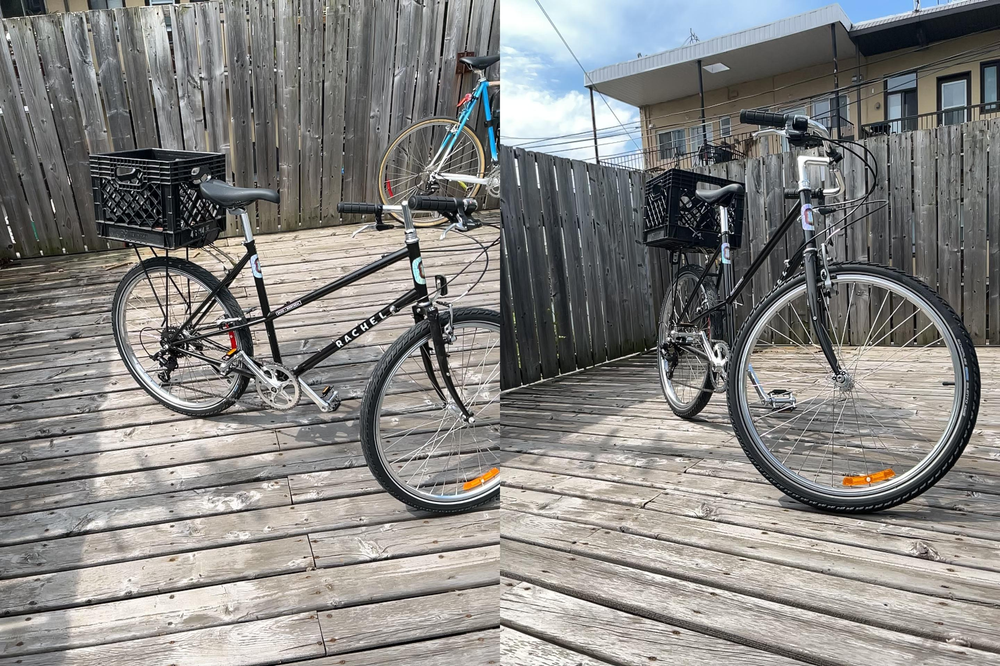

In [20]:
image_grid([Image.open(im) for im in [im0, im1]], 1, 2)

# Keypoint Matching and Fundamental Matrix 

In [21]:
def load_torch_image(fname, color=False):
    img = K.image_to_tensor(cv2.imread(fname), False).float() /255.
    if color: img = K.color.bgr_to_rgb(img)
    else: img = K.color.bgr_to_grayscale(img)
    return img

In [22]:
input_dict={"image0": load_torch_image(str(im0)),
            "image1": load_torch_image(str(im1))}

In [23]:
matcher = KF.LoFTR(pretrained='outdoor' )

In [24]:
with torch.no_grad():
    correspondences = matcher(input_dict)

In [25]:
correspondences['keypoints0'].shape, correspondences['keypoints1'].shape

(torch.Size([2613, 2]), torch.Size([2613, 2]))

In [26]:
input_dict['image0'].shape, input_dict['image1'].shape

(torch.Size([1, 1, 1920, 1440]), torch.Size([1, 1, 1920, 1440]))

## Calculate Fundamental Matrix

In [27]:
FundMat, inliers = cv2.findFundamentalMat(correspondences['keypoints0'].cpu().numpy(), 
                                          correspondences['keypoints1'].cpu().numpy(), 
                                          cv2.USAC_MAGSAC, 0.2, 0.999, 100000)

In [28]:
pd.Series(inliers.reshape((-1,))).value_counts()

0    1863
1     750
Name: count, dtype: int64

In [29]:
inliers = inliers > 0

In [38]:
inliers.flatten()

array([False, False, False, ..., False, False, False])

In [31]:
FundMat

array([[ 0.   ,  0.   , -0.006],
       [-0.   ,  0.   ,  0.003],
       [ 0.005, -0.005,  2.54 ]])

In [32]:
correspondences['keypoints0'].shape, correspondences['keypoints0'].view(1,-1, 2).shape

(torch.Size([2613, 2]), torch.Size([1, 2613, 2]))

In [33]:
KF.laf_from_center_scale_ori(correspondences['keypoints0'].view(1,-1, 2),
                                torch.ones(correspondences['keypoints0'].shape[0]).view(1,-1, 1, 1),
                                torch.ones(correspondences['keypoints0'].shape[0]).view(1,-1, 1))


tensor([[[[ 9.9985e-01,  1.7452e-02,  3.6000e+02],
          [-1.7452e-02,  9.9985e-01,  1.6000e+01]],

         [[ 9.9985e-01,  1.7452e-02,  5.6800e+02],
          [-1.7452e-02,  9.9985e-01,  1.6000e+01]],

         [[ 9.9985e-01,  1.7452e-02,  5.8400e+02],
          [-1.7452e-02,  9.9985e-01,  1.6000e+01]],

         ...,

         [[ 9.9985e-01,  1.7452e-02,  1.3760e+03],
          [-1.7452e-02,  9.9985e-01,  1.8560e+03]],

         [[ 9.9985e-01,  1.7452e-02,  4.3200e+02],
          [-1.7452e-02,  9.9985e-01,  1.8800e+03]],

         [[ 9.9985e-01,  1.7452e-02,  1.1280e+03],
          [-1.7452e-02,  9.9985e-01,  1.8960e+03]]]])

In [34]:
 #K.tensor_to_image(img1)

 ## show the key points

In [35]:
def add_pnt2img(im, kpnt):
    blue=tuple((np.array([0.2, 0.5, 1])*255).astype(int))
    im=Image.open(im)
    draw = ImageDraw.Draw(im)
    for pnt in kpnt:
        draw.ellipse([tuple(pnt), tuple(pnt+5)], fill=blue, width=10)
    
    return im

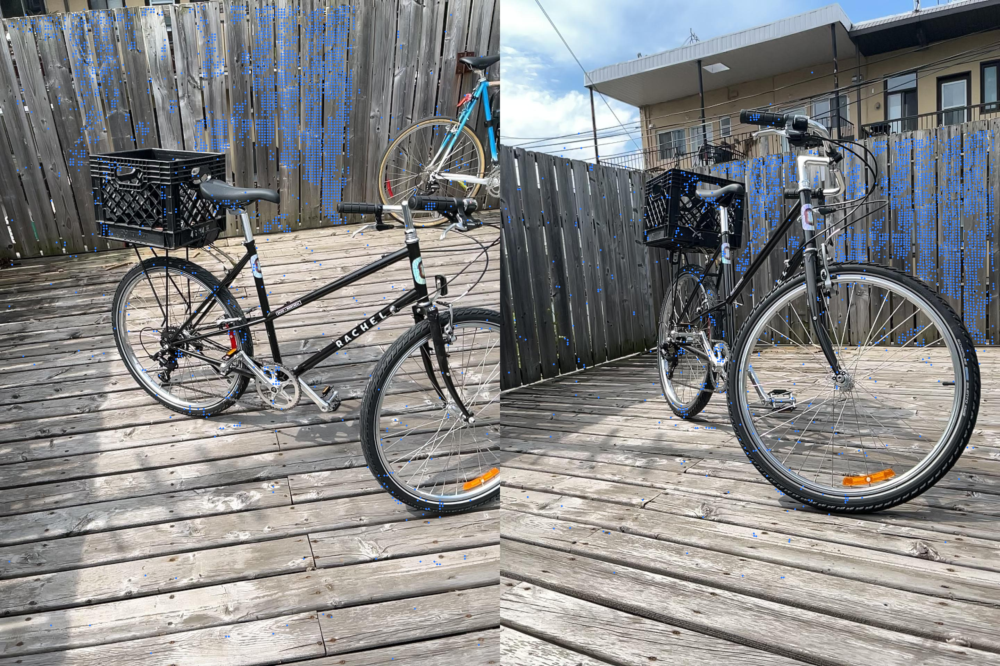

In [36]:
image_grid([add_pnt2img(im, correspondences[f'keypoints{j}'].numpy()) for j, im in enumerate([im0, im1])], 1, 2)

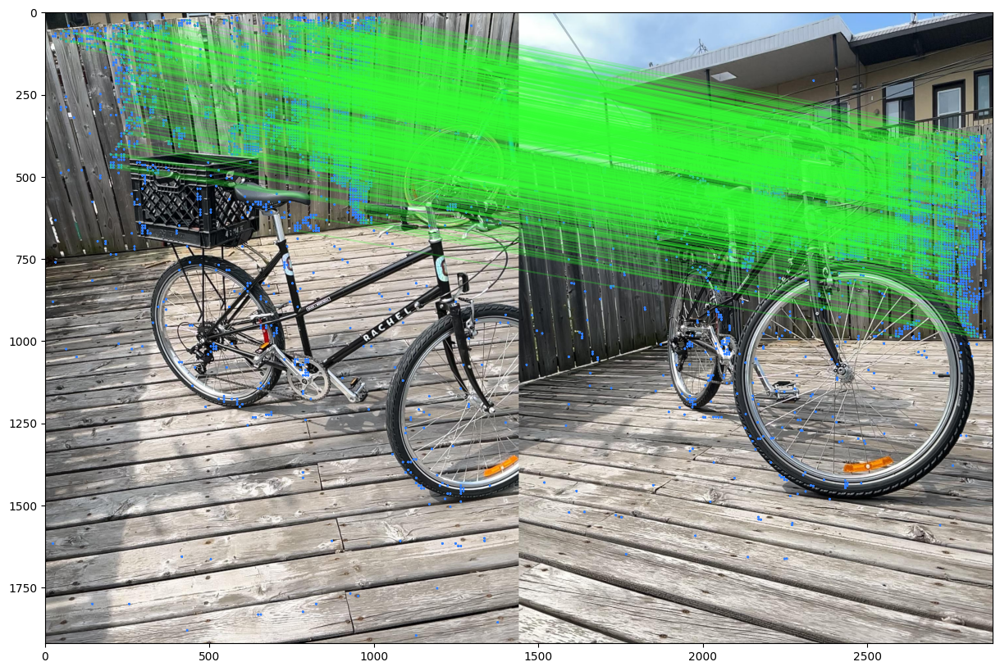

In [37]:
draw_LAF_matches(
    KF.laf_from_center_scale_ori(correspondences['keypoints0'].view(1,-1, 2),
                                torch.ones(correspondences['keypoints0'].shape[0]).view(1,-1, 1, 1),
                                torch.ones(correspondences['keypoints0'].shape[0]).view(1,-1, 1)),

    KF.laf_from_center_scale_ori(correspondences['keypoints1'].view(1,-1, 2),
                                torch.ones(correspondences['keypoints1'].shape[0]).view(1,-1, 1, 1),
                                torch.ones(correspondences['keypoints1'].shape[0]).view(1,-1, 1)),
    torch.arange(correspondences['keypoints0'].shape[0]).view(-1,1).repeat(1,2),
    K.tensor_to_image(load_torch_image(str(im0), color=True)),
    K.tensor_to_image(load_torch_image(str(im1), color=True)),
    inliers,
    draw_dict={'inlier_color': (0.2, 1, 0.2, 0.25),
               'tentative_color': None, 
               'feature_color': (0.2, 0.5, 1), 'vertical': False})

# From Fundamaental Matrix to Essential Matrix

$\mathbf{E=K^TFK}$


where: 
* $\mathbf{E}$ is the Essential matrix
* $\mathbf{K}$ is the camera calibration matrix
* $\mathbf{F}$ is the Fundamental matrix

In [43]:
_,_, hght,wdth =input_dict["image0"].shape

In [45]:
cy=hght/2
cx=wdth/2

In [ ]:
cv2.calibrateCamera()

In [ ]:
CamCalMat

In [ ]:
EssntlMat = CamCalMat.T.dot(FundMat.dot(CamCalMat))

In [ ]:
EssntlMat

In [ ]:
mask=inliers.flatten()

In [ ]:
_,R,t,_ = cv2.recoverPose(EssntlMat,img1pts[mask],img2pts[mask],self.K)